# <p style="text-align:center"> <font color='darkorange'>**CUNEF**</font>
## <p style="text-align:center"> **Practice III - Retail score analysis**
#### <p style="text-align:center"> **Machine Learning**</strong><br />
    
<p style="text-align:left">Pablo Mazariegos Reviriego - <font color='orange'>pablo.mazariegos@cunef.edu </font>
    
<p style="text-align:left">Mario Sabater Pascual - <font color='orange'>mario.sabater@cunef.edu </font>

![Highway](https://www.restaurant-hospitality.com/sites/restaurant-hospitality.com/files/styles/article_featured_retina/public/uploads/2013/07/yelplogopromo.jpg?itok=OM0azJTj)

In this Machine Learning practice we will be working with the **Yelp dataset**. The whole practice will be composed by the following notebooks:

 0. <font color='darkgreen'>**Data Reading and Problem statement**</font>
 1. Data selection & variables preparation
 2. EDA
 3. Model selection
 4. Best Model and Explainability
 5. Variables Relationship (Graphs)

This notebook will go, from reading the files in JSON format, to present a problem that will be interesting and possible to approach with the availabe data and through machine learning. The index goes as it follows:

 - [Libraries import](#0) 

 - [Functions used in this notebook](#1) 

 - [Fist glance at the data](#2) 
 
  - [Business](#2.1) 
  - [Checkin](#2.2) 
  - [Review](#2.3) 
  - [Tip](#2.4) 
  - [User](#2.5) 

 - [Problem statement](#3)

##  <a name="0"> **Libraries import**</a>

In [1]:
import json
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
import matplotlib.gridspec as gridspec
from pandas.plotting import autocorrelation_plot
import seaborn as sns
import plotly.express as px
import scipy.stats as ss
import math
import folium
from folium import Choropleth, Circle, Marker
from folium.plugins import HeatMap, MarkerCluster

import warnings
warnings.filterwarnings('ignore')

##  <a name="1"> **Functions used in this notebook**</a>

In [2]:
def json_to_dataframes(json_file, name, parts):
  # Opening the JSON file and reading by line in a list
  with open(json_file, "r", errors='ignore') as f:
    data = f.readlines()
  
  # Creation of a list to store the dictionaries
  dict_list = []
  
  # Iteramos sobre las líneas del fichero y cargamos cada línea como un diccionario
  for line in data:
    dict_list.append(json.loads(line))
  
  # Creamos un dataframe a partir de la lista de diccionarios
  df = pd.DataFrame.from_dict(dict_list)
  
  # Calculamos el número de filas del dataframe
  num_rows = df.shape[0]
  
  # Dividimos el dataframe en 10 partes iguales y las almacenamos en una lista
  df_list = [df[i:i+num_rows//parts] for i in range(0, num_rows, num_rows//parts)]
  
  # Creamos una lista con los nombres de los dataframes
  df_names = [f"{name}{i+1}" for i in range(parts)]
  
  # Asignamos los nombres a los dataframes y los almacenamos en un diccionario
  df_dict = {df_names[i]: df_list[i] for i in range(parts)}
  
  # Devolvemos el número de filas y el diccionario de dataframes
  return df_dict

To facilitate the reading of the json file and in order to not store a large volume of data in memory, we use the function **json_to_dataframe**. This function allows us to divide the json file in a number of equal parts (using the value "parts" od the function) and load only the ones we are interested in, in this way we can work with a percentaje of the data and visualize them in such a way that we can get an idea of the information contained in the selected json file.

Also the function allows to call the dataframe via df_dict["_name_ 1"], where name is the second value we give to the **json_to_dataframes** function.

##  <a name="2"> **Fist glance at the data**</a>

**The data**

As it is described in the yelp website, the dataset is "_a subset of our businesses, reviews, and user data for use in personal, educational, and academic purposes. Available as JSON files, use it to teach students about databases, to learn NLP, or for sample production data while you learn how to make mobile apps_".

The original datset contains information of:
 - 6,990,280 reviews.
 - 150,346 businesses.
 - 200,100 pictures.
 - 11 metropolitan areas.
 - 908,915 tips by 1,987,897 users.
 - Over 1.2 million business attributes like hours, parking, availability, and ambience
 - Aggregated check-ins over time for each of the 131,930 businesses.
 
**For the purpose of this project we will discard the 200,100 pictures**. Besides this, the rest of the information is registered in 5 JSON files, all labeled as "_yelp_academic_dataset_" +:
 - "_business_"
 - "_checkin_"
 - "_review_"
 - "_tip_"
 - "_user_"

The dataset and its terms and conditions file are availabe to download in:

https://www.yelp.com/dataset

As we can deduct from we just read about the data, the file size makes it completely unefficient to work with the complete files and load them in the memory or even use them as a _.csv_ file. Hence, the function afore defined, **json_to_dataframe**

##  <a name="2.1"> **Business**</a>

### Data reading

We use the json_to_dataframes function, calling the subsequent files business1 to business 10, since we decided to divide the file into 10 parts.

In [3]:
df_dict = json_to_dataframes("../data/raw/yelp_academic_dataset_business.json", "business",10)

In [4]:
business1 = df_dict["business1"]
business1.head()

,business_id,name,address,city,state,postal_code,latitude,longitude,stars,review_count,is_open,attributes,categories,hours
0,Pns2l4eNsfO8kk83dixA6A,"Abby Rappoport, LAC, CMQ","1616 Chapala St, Ste 2",Santa Barbara,CA,93101,34.426679,-119.711197,5.0,7,0,{'ByAppointmentOnly': 'True'},"Doctors, Traditional Chinese Medicine, Naturop...",None
1,mpf3x-BjTdTEA3yCZrAYPw,The UPS Store,87 Grasso Plaza Shopping Center,Affton,MO,63123,38.551126,-90.335695,3.0,15,1,{'BusinessAcceptsCreditCards': 'True'},"Shipping Centers, Local Services, Notaries, Ma...","{'Monday': '0:0-0:0', 'Tuesday': '8:0-18:30', ..."
2,tUFrWirKiKi_TAnsVWINQQ,Target,5255 E Broadway Blvd,Tucson,AZ,85711,32.223236,-110.880452,3.5,22,0,"{'BikeParking': 'True', 'BusinessAcceptsCredit...","Department Stores, Shopping, Fashion, Home & G...","{'Monday': '8:0-22:0', 'Tuesday': '8:0-22:0', ..."
3,MTSW4McQd7CbVtyjqoe9mw,St Honore Pastries,935 Race St,Philadelphia,PA,19107,39.955505,-75.155564,4.0,80,1,"{'RestaurantsDelivery': 'False', 'OutdoorSeati...","Restaurants, Food, Bubble Tea, Coffee & Tea, B...","{'Monday': '7:0-20:0', 'Tuesday': '7:0-20:0', ..."
4,mWMc6_wTdE0EUBKIGXDVfA,Perkiomen Valley Brewery,101 Walnut St,Green Lane,PA,18054,40.338183,-75.471659,4.5,13,1,"{'BusinessAcceptsCreditCards': 'True', 'Wheelc...","Brewpubs, Breweries, Food","{'Wednesday': '14:0-22:0', 'Thursday': '16:0-2..."


Here, by observing the first 5 rows of business we can make up an idea of what info the file contains. As can be also deducted from the name, the file contains information about the different businesses recorded in the database, we do have the basics being theses the name, adress, city, state, if it is opened or not or the schedule, as well as well as others that can be more interesting for our purposes:

 - **business_id**: A ser of letters, numbers and characters that represents a unique business. This can be used to join the tables that also cointain this info. 
 - **latitude & longitude**: The exact location of the business. A helpfull variable in case we want to represent them in a map.
 - **stars & review_count**: The average rating of the business in Yelp as well as the number of reviews registered in the website. 
 - **atributes & categories**: Useful information to understand the activityy of such business as the sector (in categories) and if it is dog friendly or accepts credit cards (in atributes).

### Data visualization

**Ratings distribution**

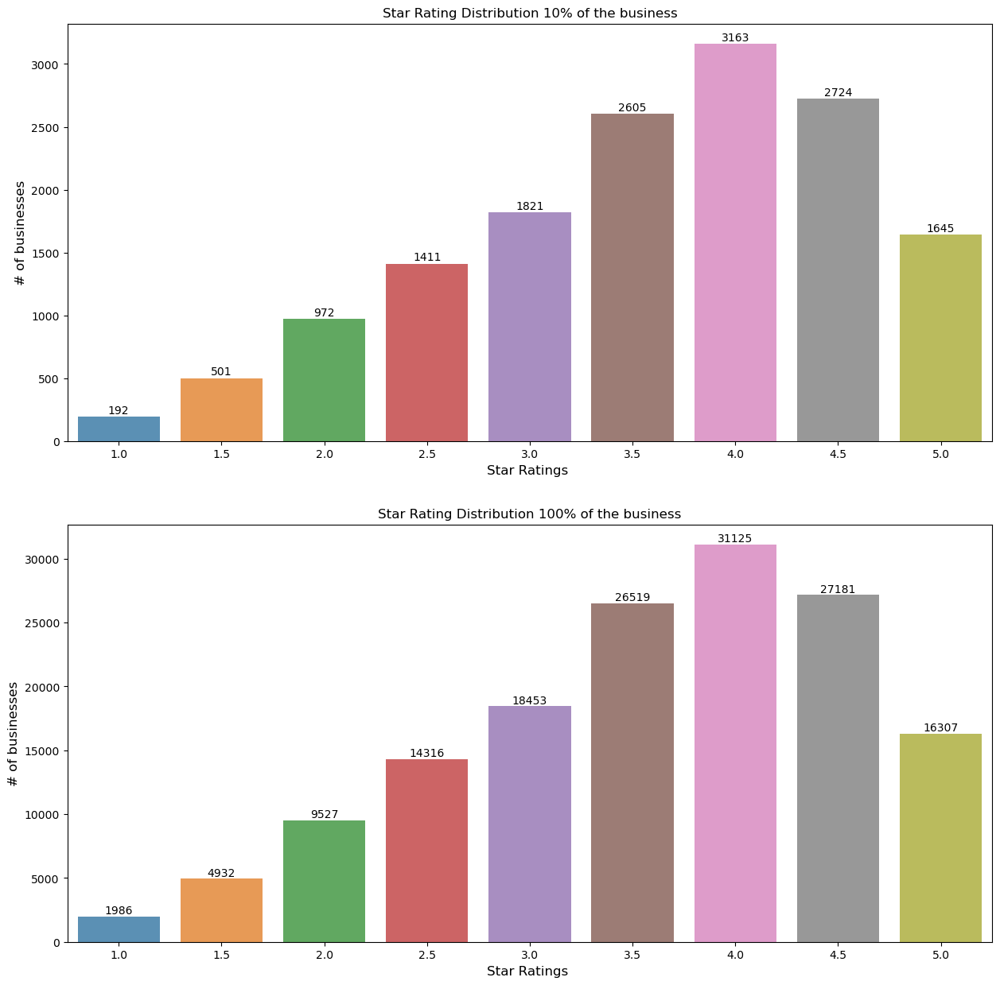

In [5]:
# Create a figure with two subplots
fig, axs = plt.subplots(2, 1, figsize=(15, 15), sharex=False)

# Plot the first graph having it done with business1 (10% of the data)
# Get the distribution of the ratings
x = business1['stars'].value_counts()
x = x.sort_index()

# Plot the bar chart
axs[0] = sns.barplot(x=x.index, y=x.values, alpha=0.8,  ax=axs[0])
axs[0].set_title("Star Rating Distribution 10% of the business")
axs[0].set_ylabel('# of businesses', fontsize=12)
axs[0].set_xlabel('Star Ratings ', fontsize=12)

# Adding the text labels
rects = axs[0].patches
labels = x.values
for rect, label in zip(rects, labels):
    height = rect.get_height()
    axs[0].text(rect.get_x() + rect.get_width()/2, height + 5, label, ha='center', va='bottom')

# Open the JSON file in read mode
with open('../data/raw/yelp_academic_dataset_business.json', 'r') as f:
    # Initialize the ratings list
    ratings = []
    
    # Iterate over the lines in the file
    for line in f:
        # Load the line as a JSON object
        data = json.loads(line)
        
        # Append the rating to the list
        ratings.append(data['stars'])

# Get the distribution of the ratings
x1 = pd.Series(ratings).value_counts()
x1 = x1.sort_index()

# Plot the bar chart
axs[1] = sns.barplot(x=x1.index, y=x1.values, alpha=0.8, width=0.8,  ax=axs[1])
axs[1].set_title("Star Rating Distribution 100% of the business")
axs[1].set_ylabel('# of businesses', fontsize=12)
axs[1].set_xlabel('Star Ratings ', fontsize=12)

# Adding the text labels
rects = axs[1].patches
labels = x1.values
for rect, label in zip(rects, labels):
    height = rect.get_height()
    axs[1].text(rect.get_x() + rect.get_width()/2, height + 5, label, ha='center', va='bottom')

**Number of reviews distribution**

Let's visualize the distribution of number of reviews that a business has, we have applied log since the distribution is extremely skewed.

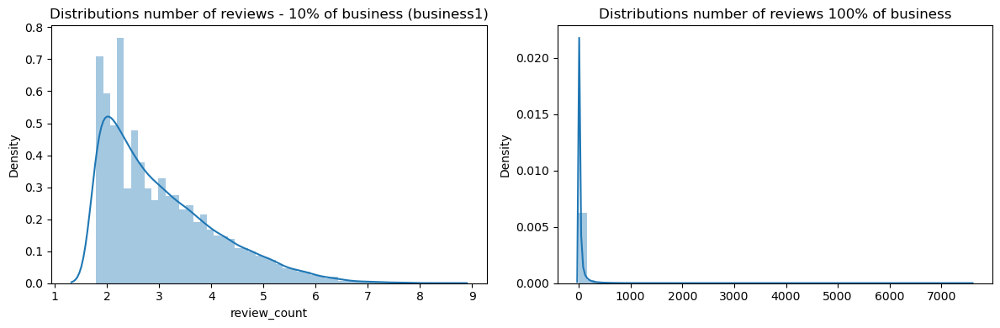

In [6]:
# Create a figure with two subplots
fig, axs = plt.subplots(1, 2, figsize=(12, 4))

# Plot the first graph having it done with business1 (10% of the data)
sns.distplot(business1['review_count'].apply(np.log1p), ax=axs[0])
axs[0].set_title("Distributions number of reviews - 10% of business (business1)")

#Second graph with the whole json:
    # Read the json file
with open("../data/raw/yelp_academic_dataset_business.json", "r") as f:
    businesses = f.readlines()

    # Remove the trailing whitespaces and parse the json objects
businesses = [json.loads(business.strip()) for business in businesses]

    # Extract the review counts from the businesses
review_counts = [business["review_count"] for business in businesses]

    # Plot the distribution plot
sns.distplot(review_counts, ax=axs[1])
axs[1].set_title("Distributions number of reviews 100% of business")

    # Adjust the spacing between the two subplots
fig.tight_layout()

As we stated before, the Yelp dataset contains information of 150.346 businesses. In order to have an idea of how the data looked like without using too much memory, we used the funtion json_to_dataframe, by doing this we obtain a smaller dataframe. 

Looking at the four previous graphs (Star rating distribution and Number of reviews distribution). We can conclude that at first, the business1 dataframe (which is a the first 10% of the business json) is a representative sample of it. We find the main difference in the number of reviews distribution, in which the whole data has business with more than 7k reviews, but we can understand those almost as a outlier, since the main density is on the extreme left of the distribution graph.

Whenevere is possible, we will use the whole dataset, otherwise, the percetaje of the data selected (in this case 10% of business) will be used.

**Business Map visualization**

One of the main information provided by the business dataset is the location of the businesses, with variables as address, city, state, zipcode, longitude and latitude. The more accurate and easy to use for a map visualization is the last two.

In [7]:
# Open the JSON file in read mode
with open('../data/raw/yelp_academic_dataset_business.json', 'r', errors='ignore') as f:
    # Create an empty marker cluster
    mc = MarkerCluster()

    # Iterate over the lines in the file
    for line in f:
        # Load the line as a JSON object
        data = json.loads(line)

        # Check if the latitude and longitude are not null
        if not math.isnan(data['longitude']) and not math.isnan(data['latitude']):
            # Add a marker to the cluster
            mc.add_child(Marker([data['latitude'], data['longitude']]))

**Dotmap** (whole dataset)

In [8]:
# Create a Folium map
dotmap = folium.Map(location=[38.889722, -77.008889], tiles='cartodbpositron', zoom_start=3)

# Add the marker cluster to the map
dotmap.add_child(mc)

# Display the map
dotmap

**Heatmap** (10% dataset)

In [9]:
# Create a Folium map
cyclemap = folium.Map(location=[38.889722, -77.008889], tiles='cartodbpositron', zoom_start=3)

# Create a marker cluster
marker_cluster = MarkerCluster().add_to(mc)

# Create a base map
heatmap = folium.Map(location=[38.889722, -77.008889], tiles='cartodbpositron', zoom_start=3)

# Add a heatmap to the base map
HeatMap(data=business1[['latitude', 'longitude']], radius=10).add_to(heatmap)

# Display the map
heatmap

**States in the Business dataset**

As we have seen in the maps, there are several states from US and Canada represented in the business data. First thing, we will list them:

In [10]:
# Open the JSON file
with open('../data/raw/yelp_academic_dataset_business.json', 'r', errors='ignore') as f:
    # Initialize an empty list to store the states
    states = []

    # Read the file one line at a time
    for line in f:
        # Parse the line using json.loads
        data = json.loads(line)      

        # Extract the state from the data
        state = data['state']

        # Add the state to the list
        states.append(state)

# Get the unique values of the states list
unique_states = pd.unique(states)

print("THe yelp dataset, contains information of" + str(len(unique_states)) + "different states, being these:")
print(unique_states)

THe yelp dataset, contains information of27different states, being these:
['CA' 'MO' 'AZ' 'PA' 'TN' 'FL' 'IN' 'LA' 'AB' 'NV' 'ID' 'DE' 'IL' 'NJ'
 'NC' 'CO' 'WA' 'HI' 'UT' 'TX' 'MT' 'MI' 'SD' 'XMS' 'MA' 'VI' 'VT']


The only state we cannot identify is XMS. Hence, we look for that value of state in the data and look at the coordinates of an example, just in case it is outside the USA & Candad or it is just a misprint.

In [11]:
business_XMS = pd.DataFrame()

# Open the JSON file in read mode
with open('../data/raw/yelp_academic_dataset_business.json', 'r', errors='ignore') as f:
    # Iterate over the lines in the file
    for line in f:
        # Load the line as a JSON object
        obj = json.loads(line)
        # If the object has the key 'state' with the value "XMS", add it to the dataframe
        if obj['state'] == "XMS":
            business_XMS = business_XMS.append(obj, ignore_index=True)
            
business_XMS.head()            

,business_id,name,address,city,state,postal_code,latitude,longitude,stars,review_count,is_open,attributes,categories,hours
0,IvQs2hhXKZ4NgZhVZ5jjjQ,Pumpernickles Catering,95a Mount Pleasant,Liverpool,XMS,L3 5TB,38.673049,-90.423156,4.0,5,1,"{'RestaurantsPriceRange2': '2', 'BusinessParki...","Caterers, Breakfast & Brunch, Convenience Stor...",None


Looking for the coordintates, we finf the business. It is loctaed in San Luis, Missouri. Since we do have a large sample of data and the city and state are not correct, for the safaty and the sturdiness of our data we will not include it. But for the moment, we will ignore this business and we will plot the top 15 states represented in the business dataset.

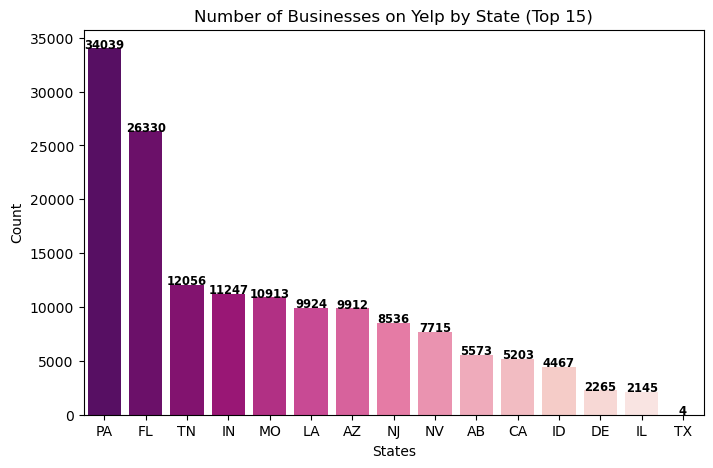

In [12]:
state_counts = {}
# Open the JSON file
with open('../data/raw/yelp_academic_dataset_business.json', 'r', errors='ignore') as f:
    # Read the file line by line
    for line in f:
        # Parse each line as a JSON object
        data = json.loads(line)
        # Extract the relevant data from the JSON object
        states.append(data['state'])
        # Count the number of occurrences of each state
        if data['state'] not in state_counts:
            state_counts[data['state']] = 1
        else:
            state_counts[data['state']] += 1

# Sort the state counts in descending order and select the top 15 states
top15_states = sorted(state_counts, key=state_counts.get, reverse=True)[:15]
top15_counts = [state_counts[state] for state in top15_states]

# Create a Pandas DataFrame with the top 15 states and their counts
top15 = pd.DataFrame({'state': top15_states, 'count': top15_counts})

# Plot the barplot using the DataFrame
plt.figure(figsize=(8,5))
ax = sns.barplot(x='state',y='count', data=top15, palette='RdPu_r')
ax.set_ylabel('Count')
ax.set_xlabel('States')
ax.set_title('Number of Businesses on Yelp by State (Top 15)')

for p in ax.patches:
        width, height = p.get_width(), p.get_height()
        x, y = p.get_xy() 
        ax.text(x+width-.4, 
                y+height+2,
                '{:.0f}'.format(height),
                weight='bold',
                horizontalalignment='center',
               size='small') 
                
plt.show()

**Number of business open at this time**

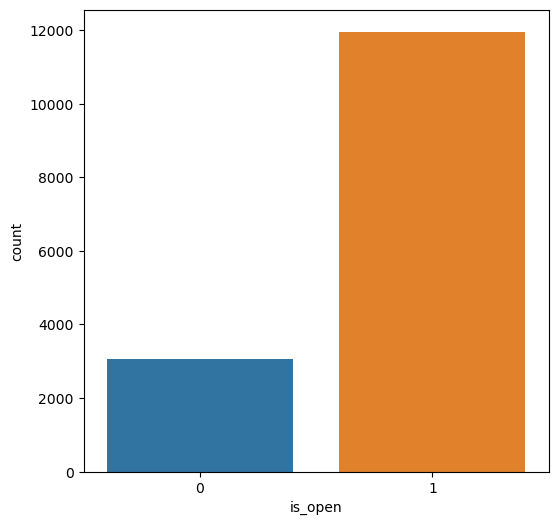

In [13]:
plt.figure(figsize=(6,6))
sns.countplot(x='is_open',data=business1);

**Hours**

In [14]:
datos_seleccionados = business1[['hours']]
datos_seleccionados['hours'] = datos_seleccionados['hours'].fillna(0)
type(datos_seleccionados['hours'])

pandas.core.series.Series

In [15]:
datos_seleccionados = datos_seleccionados['hours'].apply(pd.Series)
datos_seleccionados

,0,Monday,Tuesday,Wednesday,Thursday,Friday,Saturday,Sunday
0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,0:0-0:0,8:0-18:30,8:0-18:30,8:0-18:30,8:0-18:30,8:0-14:0,NaN
2,NaN,8:0-22:0,8:0-22:0,8:0-22:0,8:0-22:0,8:0-23:0,8:0-23:0,8:0-22:0
3,NaN,7:0-20:0,7:0-20:0,7:0-20:0,7:0-20:0,7:0-21:0,7:0-21:0,7:0-21:0
4,NaN,NaN,NaN,14:0-22:0,16:0-22:0,12:0-22:0,12:0-22:0,12:0-18:0
...,...,...,...,...,...,...,...,...
15029,NaN,10:0-15:0,10:0-15:0,10:0-15:0,10:0-15:0,10:0-15:0,NaN,NaN
15030,NaN,0:0-0:0,8:0-22:0,8:0-22:0,8:0-22:0,8:0-15:0,8:0-10:0,8:0-22:0
15031,NaN,6:0-22:0,6:0-22:0,6:0-22:0,6:0-22:0,6:0-22:0,6:0-22:0,6:0-22:0
15032,NaN,6:0-0:0,6:0-0:0,6:0-0:0,6:0-0:0,6:0-20:0,10:30-23:59,7:0-0:0


Finally the business dataset contains the columns attributes and categories. This variables have a high complexity since they are dictionaries and lists of items within each row, and every row is practically unique. 

We will deal with this data in the following notebook: **1.Data selection & variables preparation**

##  <a name="2.2"> **Checkin**</a>

In [16]:
df_dict = json_to_dataframes("../data/raw/yelp_academic_dataset_checkin.json", "checkin",10)

In [17]:
checkin1 = df_dict["checkin1"]
checkin1.head()

,business_id,date
0,---kPU91CF4Lq2-WlRu9Lw,"2020-03-13 21:10:56, 2020-06-02 22:18:06, 2020..."
1,--0iUa4sNDFiZFrAdIWhZQ,"2010-09-13 21:43:09, 2011-05-04 23:08:15, 2011..."
2,--30_8IhuyMHbSOcNWd6DQ,"2013-06-14 23:29:17, 2014-08-13 23:20:22"
3,--7PUidqRWpRSpXebiyxTg,"2011-02-15 17:12:00, 2011-07-28 02:46:10, 2012..."
4,--7jw19RH9JKXgFohspgQw,"2014-04-21 20:42:11, 2014-04-28 21:04:46, 2014..."


Here in the Checkin JSON, we have the **business_id** variable, same as in the previous dataset and another variable called **date**. Each row of date in the dataset represents a single check-in at a specific business, and the "date" column in the dataset refers to the date and time that the check-in occurred.

Here we facing one first problem with the date variable, as only seeing 5 rows out of 131930 that the whole checkin JSON has, we can see that different business have different number of checkins (these are separated with a ","). If in our final dataset we decide to use this column, it will be the first issue to tackle.

##  <a name="2.3"> **Review**</a>

In [18]:
df_dict = json_to_dataframes("../data/raw/yelp_academic_dataset_review.json", "review",50)

In [19]:
review1 = df_dict["review1"]
review1.head()

,review_id,user_id,business_id,stars,useful,funny,cool,text,date
0,KU_O5udG6zpxOg-VcAEodg,mh_-eMZ6K5RLWhZyISBhwA,XQfwVwDr-v0ZS3_CbbE5Xw,3.0,0,0,0,"If you decide to eat here, just be aware it is...",2018-07-07 22:09:11
1,BiTunyQ73aT9WBnpR9DZGw,OyoGAe7OKpv6SyGZT5g77Q,7ATYjTIgM3jUlt4UM3IypQ,5.0,1,0,1,I've taken a lot of spin classes over the year...,2012-01-03 15:28:18
2,saUsX_uimxRlCVr67Z4Jig,8g_iMtfSiwikVnbP2etR0A,YjUWPpI6HXG530lwP-fb2A,3.0,0,0,0,Family diner. Had the buffet. Eclectic assortm...,2014-02-05 20:30:30
3,AqPFMleE6RsU23_auESxiA,_7bHUi9Uuf5__HHc_Q8guQ,kxX2SOes4o-D3ZQBkiMRfA,5.0,1,0,1,"Wow! Yummy, different, delicious. Our favo...",2015-01-04 00:01:03
4,Sx8TMOWLNuJBWer-0pcmoA,bcjbaE6dDog4jkNY91ncLQ,e4Vwtrqf-wpJfwesgvdgxQ,4.0,1,0,1,Cute interior and owner (?) gave us tour of up...,2017-01-14 20:54:15


In the "Review" JSON we find apart from the **business_id** variable the following:
 - **review_id**: A unique set of numbers, letters and special characters that identify that review. 
 - **user_id**: A unique set of numbers, letters and special characters that identify the user that has made the review.
 - **stars**: The valuation such user has give to the business.
 - **useful & funny & cool**: The users can indicate if the review is useful, funny or cool, this variables count the number of times the review has been indicated as such.
 - **text**: The review itself given by the user.
 - **date**: The date the review was posted on the yelp site.

**Data set review info**

In [20]:
print (review1.info())
print (review1.dtypes)
print (review1.shape)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 139805 entries, 0 to 139804
Data columns (total 9 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   review_id    139805 non-null  object 
 1   user_id      139805 non-null  object 
 2   business_id  139805 non-null  object 
 3   stars        139805 non-null  float64
 4   useful       139805 non-null  int64  
 5   funny        139805 non-null  int64  
 6   cool         139805 non-null  int64  
 7   text         139805 non-null  object 
 8   date         139805 non-null  object 
dtypes: float64(1), int64(3), object(5)
memory usage: 9.6+ MB
None
review_id       object
user_id         object
business_id     object
stars          float64
useful           int64
funny            int64
cool             int64
text            object
date            object
dtype: object
(139805, 9)


The reviews1 dataset has 139.805 entries and 9 columns, with that being said, this is a 2% of the reviews dataset. Here is why we use the json_to_dataframes function. Due to the size of the original json, from now on, just to take a look at the data we will use this "reviews1" dataset.

**YELP users activity**

In [21]:
review1['date'] = pd.to_datetime(review1['date'])

Text(0, 0.5, 'ratio')

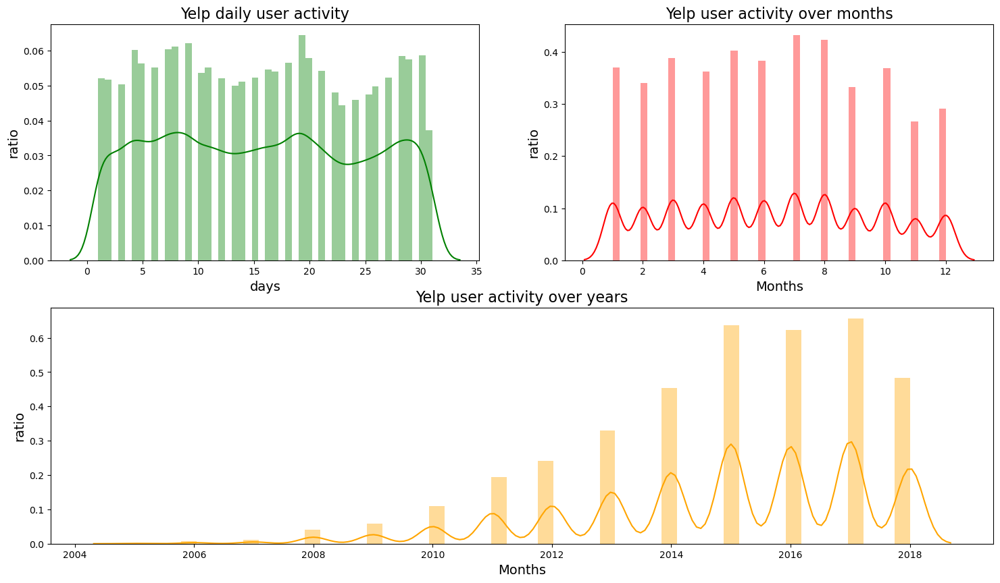

In [22]:
gridspec.GridSpec(2,2)

plt.figure(figsize=(18,10)) 

# Plotting daily activity of users on yelp
plt.subplot2grid((2,2), (0,0))
sns.distplot(review1['date'].dt.day, color='green')
plt.title('Yelp daily user activity',fontsize=16)
plt.xlabel('days', fontsize=14)
plt.ylabel('ratio', fontsize=14)

# Plotting activity of usres on yelp over a month
plt.subplot2grid((2,2), (0,1))
sns.distplot(review1['date'].dt.month, color='red')
plt.title('Yelp user activity over months',fontsize=16)
plt.xlabel('Months', fontsize=14)
plt.ylabel('ratio', fontsize=14)

# Plotting activity of usres on yelp over an year
plt.subplot2grid((2,2), (1,0),colspan=2, rowspan=2)
sns.distplot(review1['date'].dt.year, color='orange')
plt.title('Yelp user activity over years',fontsize=16)
plt.xlabel('Months', fontsize=14)
plt.ylabel('ratio', fontsize=14)

For these graphs in the user activity we can conclude that there are barely no changes between days of the montsh in whuch the users post more reviews, but for months we can se a decrease for November and December, meanwhile the during July and August are those month in which more reviews are post.

In the graph user activity over years, we can observe the increase in populary over the time spam in the dataset. For the 2018 could be three different things:
 1. The yelp dataset stops mid 2018.
 2. The reviews1 that only holds 2% of the data has less 2018 data.
 3. There was a decrease in yelp popularity in 2018.
 
In case we use this data, we will have to look at it and decide whether the use the 2018 data or not.

**Votes for reviews**


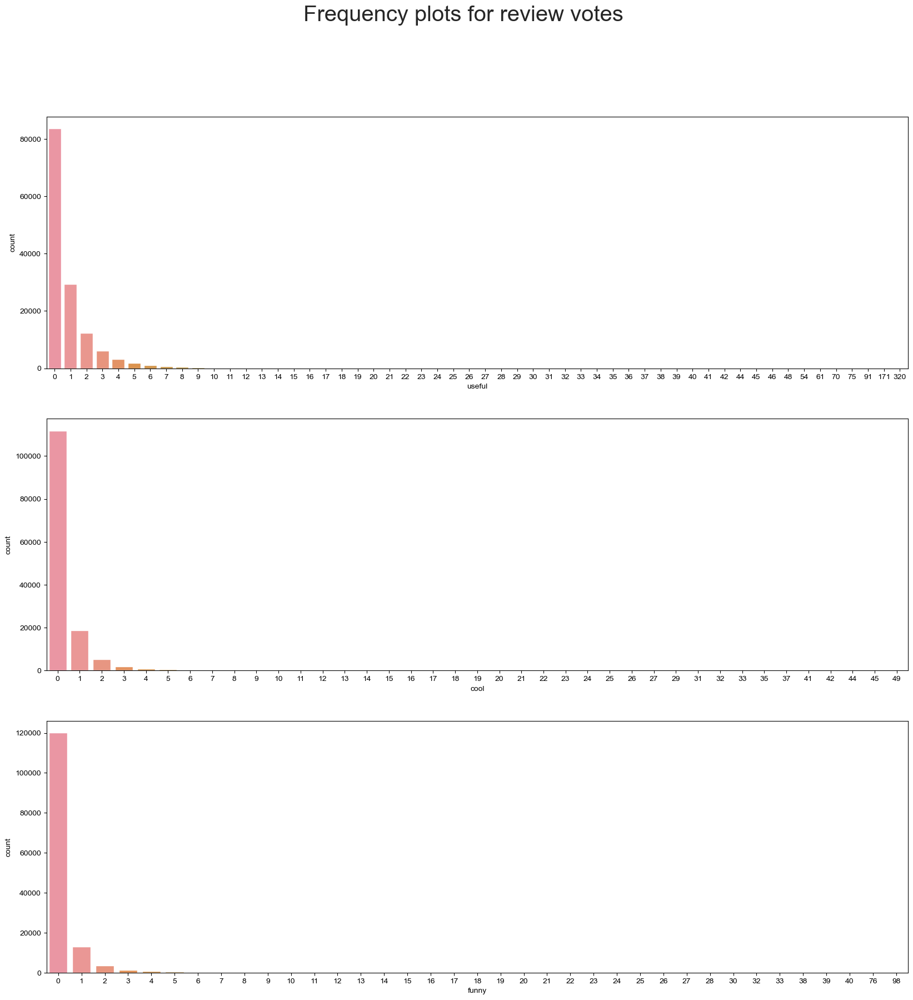

In [23]:
f,(ax1, ax2,ax3) = plt.subplots(3,figsize = (20,20))
sns.set(font_scale = 2)
f.suptitle("Frequency plots for review votes")
sns.set_style("whitegrid")

sns.countplot(x = 'useful', data = review1,ax = ax1)
sns.countplot(x = 'cool', data = review1,ax = ax2)
sns.countplot(x = 'funny', data = review1,ax = ax3)
ax1.grid(False)
ax2.grid(False)
ax3.grid(False)

We can observe that the function to tag the reviews as funny, cool or useful is varely used sepecially the first two. With some exceptions the reviews have only 0 to 4 of these tags, being the most predominant by far the 0. 

At first, we can conclude that this will not provide much information.

##  <a name="2.4"> **Tip**</a>

In [24]:
df_dict = json_to_dataframes("../data/raw/yelp_academic_dataset_tip.json", "tip", 50)

In [25]:
tip1 = df_dict["tip1"]
tip1.head()

,user_id,business_id,text,date,compliment_count
0,AGNUgVwnZUey3gcPCJ76iw,3uLgwr0qeCNMjKenHJwPGQ,Avengers time with the ladies.,2012-05-18 02:17:21,0
1,NBN4MgHP9D3cw--SnauTkA,QoezRbYQncpRqyrLH6Iqjg,They have lots of good deserts and tasty cuban...,2013-02-05 18:35:10,0
2,-copOvldyKh1qr-vzkDEvw,MYoRNLb5chwjQe3c_k37Gg,It's open even when you think it isn't,2013-08-18 00:56:08,0
3,FjMQVZjSqY8syIO-53KFKw,hV-bABTK-glh5wj31ps_Jw,Very decent fried chicken,2017-06-27 23:05:38,0
4,ld0AperBXk1h6UbqmM80zw,_uN0OudeJ3Zl_tf6nxg5ww,Appetizers.. platter special for lunch,2012-10-06 19:43:09,0


Here in the Tip dataset we can find the **user_id**; **business_id**; the **date**, in which the tip has been posted; **compliment_count**, a counter that find the tip useful; and, the **text**, the tip itself provided by the user. 

##  <a name="2.5"> **User**</a>

In [26]:
df_dict = json_to_dataframes("../data/raw/yelp_academic_dataset_user.json", "user", 10)

In [27]:
user1 = df_dict["user1"]
user1.head()

,user_id,name,review_count,yelping_since,useful,funny,cool,elite,friends,fans,...,compliment_more,compliment_profile,compliment_cute,compliment_list,compliment_note,compliment_plain,compliment_cool,compliment_funny,compliment_writer,compliment_photos
0,qVc8ODYU5SZjKXVBgXdI7w,Walker,585,2007-01-25 16:47:26,7217,1259,5994,2007,"NSCy54eWehBJyZdG2iE84w, pe42u7DcCH2QmI81NX-8qA...",267,...,65,55,56,18,232,844,467,467,239,180
1,j14WgRoU_-2ZE1aw1dXrJg,Daniel,4333,2009-01-25 04:35:42,43091,13066,27281,"2009,2010,2011,2012,2013,2014,2015,2016,2017,2...","ueRPE0CX75ePGMqOFVj6IQ, 52oH4DrRvzzl8wh5UXyU0A...",3138,...,264,184,157,251,1847,7054,3131,3131,1521,1946
2,2WnXYQFK0hXEoTxPtV2zvg,Steph,665,2008-07-25 10:41:00,2086,1010,1003,"2009,2010,2011,2012,2013","LuO3Bn4f3rlhyHIaNfTlnA, j9B4XdHUhDfTKVecyWQgyA...",52,...,13,10,17,3,66,96,119,119,35,18
3,SZDeASXq7o05mMNLshsdIA,Gwen,224,2005-11-29 04:38:33,512,330,299,"2009,2010,2011","enx1vVPnfdNUdPho6PH_wg, 4wOcvMLtU6a9Lslggq74Vg...",28,...,4,1,6,2,12,16,26,26,10,9
4,hA5lMy-EnncsH4JoR-hFGQ,Karen,79,2007-01-05 19:40:59,29,15,7,,"PBK4q9KEEBHhFvSXCUirIw, 3FWPpM7KU1gXeOM_ZbYMbA...",1,...,1,0,0,0,1,1,0,0,0,0


Finally as stated in the name, the user dataset contains information on the user. Here, apart from the **user_id** we have:
 - **name**: name of the user.
 - **review_count**: number of reviews given by the user.
 - **yelping_since**: Date the user created the account on the yelp website.
 - **useful, funny & cool**: Number of times the reviews of the user has been assignated as such by other users.
 - **elite**: Years the user has become elite. To become elite you need to apply and it gives you perks and other benefits. 
 - **friends**: other users that are friends with such users. Each row is composed by the friends users id, separated by comma.
 - **fans**: number of people that follows the user. The difference is that here, we have a count, no the user id, and fans are a unilateral relationship, the user does not have to accept it.
 - **average_stars**: The average review the user gives
 - **compliment_""**:number of times that user has receive that kind of compliment (hot, more, profile, cute, list, note, plain, cool, funny, writer or photos)

**Correlation Matrix for users and it's attributes**

The correlation matrix shows correlations between review count by each user, average star rating given by that user, Useful votes count the reviews received and number of fans following that user.

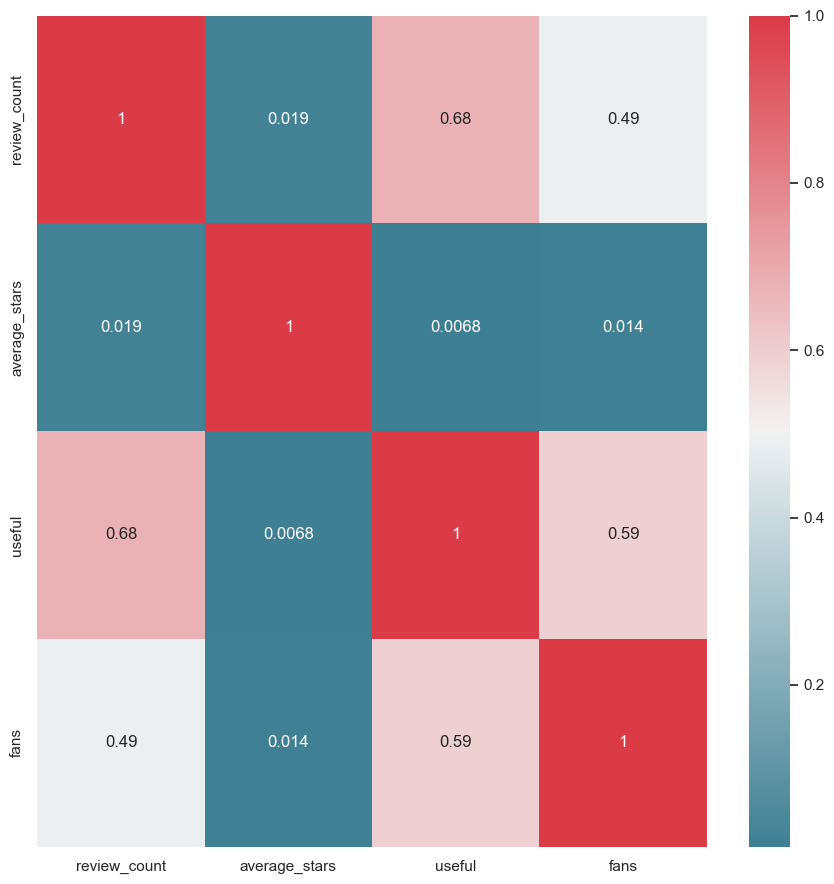

In [28]:
yelp_user = user1 [['review_count','average_stars','useful','fans']]
# plot the correlation matrix using seaborn
cmap = sns.diverging_palette(220, 10, as_cmap=True) # one of the many color mappings
sns.set(style="darkgrid") # one of the many styles to plot using
f, ax = plt.subplots(figsize=(9, 9))
sns.heatmap(yelp_user.corr(), cmap=cmap, annot=True)
f.tight_layout()

As seen, there exists a strong correlations between review counts, useful review votes (showing the motivation reviewer receives for writing reviews) and number of fans. This is expected as more number of people will follow the reviewer if the reviews are useful. However, there is almost no correlation in his fan following and the average star rating the reviewer gives to businesses.

**Influencers**

There are number of open ended questions which we could answer using the above datasets such as:

Who are the top influencers?

How many reviews are useful to the people?

How many people follow these influencers?

In [29]:
# Getting the Users(Yelpers) based on review counts
review_total =  user1.sort_values(by='review_count',ascending=True)

# Getting the Users based on number of fans
fans =  user1.sort_values(by='fans',ascending=True)

# Getting the Users based on number of total friends on yelp
user1['total_friends'] = [len( user1.iloc[i,8]) for i in range(0,198789)]
friends =  user1.sort_values(by='total_friends',ascending=True)

# Getting the Users based on number of useful reviews 
useful = user1.sort_values(by='useful',ascending=True)

In [30]:
# Create new column named 'ratio'
user1['ratio'] = (user1['useful'] * user1['review_count']) / sum(user1['review_count'])

In [31]:
# Creating new dataset with User data
Top_influencer = user1.sort_values(by='ratio',ascending=True)[['name','review_count','useful','ratio','yelping_since']]

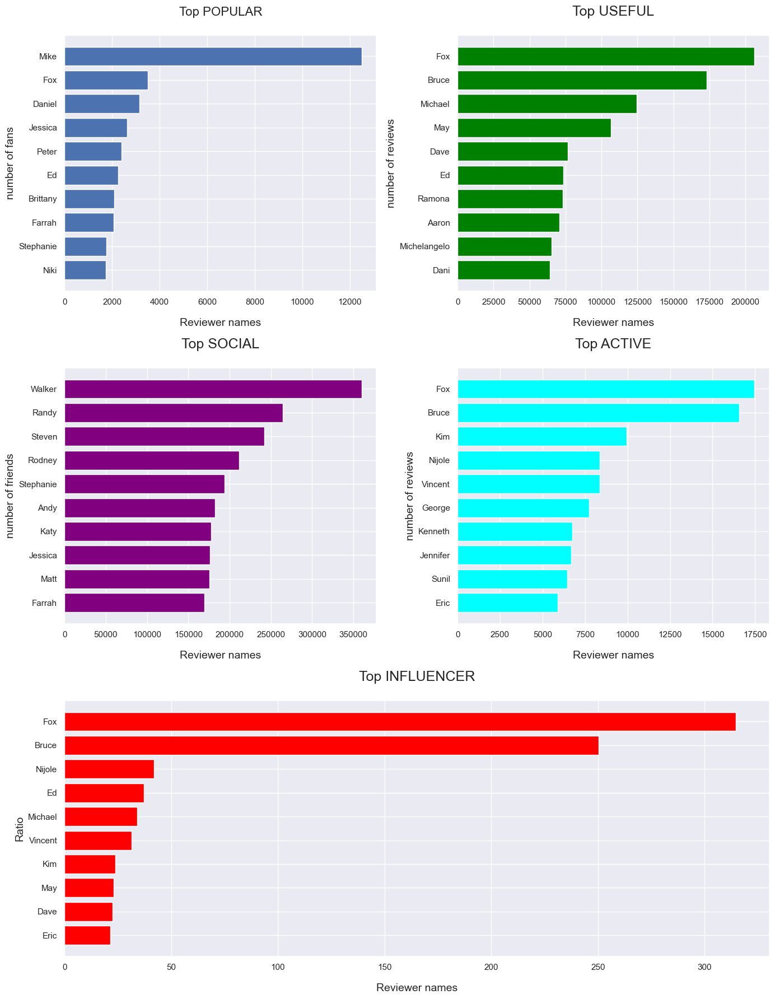

In [32]:
import matplotlib.gridspec as gridspec

gridspec.GridSpec(3,2)
plt.figure(figsize=(14,18)) 

# Plotting the most popular reviewers based on the count of their fans
plt.subplot2grid((3,2), (0,0))
plt.barh(fans['name'][-10:],fans['fans'][-10:])
#plt.barh(fans['name'][:10],fans['fans'][:10])

plt.title('Top POPULAR',fontsize=16, pad=25.0) 
plt.xlabel('Reviewer names', fontsize=14, labelpad=15.0)
plt.ylabel('number of fans', fontsize=14)

# Plotting the 10 most popular reviewers based on the count of their useful reviews
#plt.subplot(322)
plt.subplot2grid((3,2), (0,1))
plt.barh(useful['name'][-10:],useful['useful'][-10:],color='green')

plt.title('Top USEFUL',fontsize=18, pad=25.0) 
plt.xlabel('Reviewer names', fontsize=14, labelpad=15.0)
plt.ylabel('number of reviews', fontsize=14)

# Plotting the 10 most popular reviewers based on the count of their friends on yelp
#plt.subplot(323)
plt.subplot2grid((3,2), (1,0))
plt.barh(friends['name'][-10:],friends['total_friends'][-10:],color='purple')

plt.title('Top SOCIAL',fontsize=18, pad=25.0) 
plt.xlabel('Reviewer names', fontsize=14, labelpad=15.0)
plt.ylabel('number of friends', fontsize=14)

# Plotting the 10 most popular reviewers based on the count of their reviews posted on yelp
#plt.subplot(324)
plt.subplot2grid((3,2), (1,1))
plt.barh(review_total['name'][-10:],review_total['review_count'][-10:],color='cyan')

plt.title('Top ACTIVE',fontsize=18, pad=25.0) 
plt.xlabel('Reviewer names', fontsize=14, labelpad=15.0)
plt.ylabel('number of reviews', fontsize=14)

# Plotting the 10 most popular reviewers based on the ratio of their useful reviews to total reviews
#plt.subplot(325)
plt.subplot2grid((3,2),(2,0),colspan=2, rowspan=2)
plt.barh(Top_influencer['name'][-10:],Top_influencer['ratio'][-10:],color='red')

plt.title('Top INFLUENCER',fontsize=18, pad=25.0) 
plt.xlabel('Reviewer names', fontsize=14, labelpad=15.0)
plt.ylabel('Ratio', fontsize=14)

# comment out the following line and run cell to see the difference it makes
plt.tight_layout() # makes sure there is no overlap in plots 
plt.show()

One of the fenomenoms of the 21st century is the born of influencers. Best known thanks to Instagram, here we can conlude that there are some people or experts. These people are users are more active thanks to the number of reviews.

We can graph the most popular by the number of fans they have. Who would be the most social user by number of friends. Who would be the most useful user by the number of useful reviews. And who is the biggest influencer depending on the ratio obtained from their reviews by the rest of the users.

A bad review by one of this users could end up in more bad reviews of the business, lowering the average review points. Depending on the question to answer, this information can be useful.

**User summary stats**

In [33]:
user_agg=review1.groupby('user_id').agg({'review_id':['count'],'date':['min','max'],
                                'useful':['sum'],'funny':['sum'],'cool':['sum'],
                               'stars':['mean']})

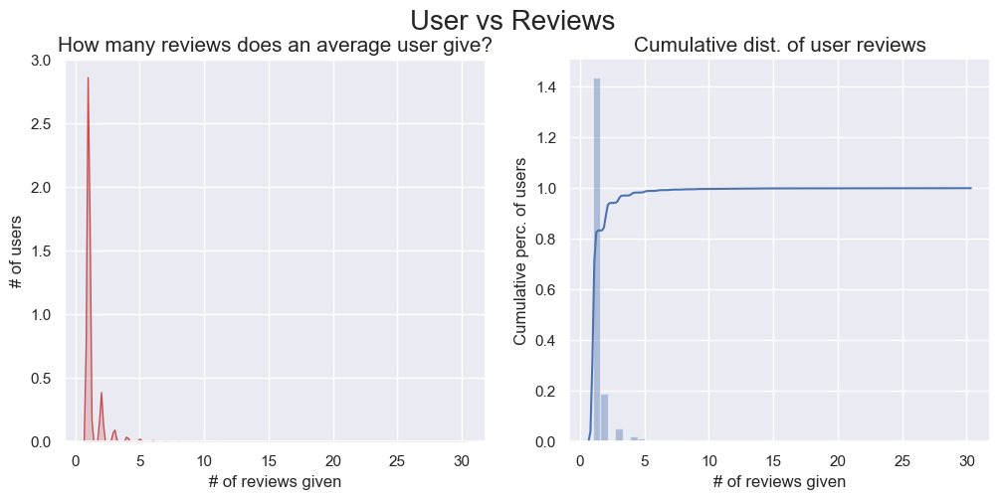

In [34]:
import matplotlib.gridspec as gridspec
import time

# Cap max reviews to 30 for better visuals
user_agg[('review_id','count')].loc[user_agg[('review_id','count')]>30] = 30
plt.figure(figsize=(12,5))
plt.suptitle("User vs Reviews",fontsize=20)
gridspec.GridSpec(1,2)
plt.subplot2grid((1,2),(0,0))
#Cumulative Distribution
ax=sns.kdeplot(user_agg[('review_id','count')],shade=True,color='r')
plt.title("How many reviews does an average user give?",fontsize=15)
plt.xlabel('# of reviews given', fontsize=12)
plt.ylabel('# of users', fontsize=12)

#Cumulative Distribution
plt.subplot2grid((1,2),(0,1))
sns.distplot(user_agg[('review_id','count')],
             kde_kws=dict(cumulative=True))
plt.title("Cumulative dist. of user reviews",fontsize=15)
plt.ylabel('Cumulative perc. of users', fontsize=12)
plt.xlabel('# of reviews given', fontsize=12)

plt.show()

Oposing to the influercer we have seen, the majority of the user, only provide 1 to 5 reviews most of the time. Hence the amount of users (almost 2 million) and the amount of reviews (just below 7 million). 

##  <a name="3"> Problem statement</a>

##### 4 STARS OR MORE

As a business stand point, if you are in Yelp, you try to obtain the best score as possible. But being pragmatic, it seems almost impossible having a 5 stars review everythime. Having an average of 4/5 stars is something more plausive as the same time as an amazing puntuation. 

Hence, In the following notebooks **we will try to predict given a certain characteristics of the business if the puntuation will be 4 stars or higher (stating it as a succesfull business) or not**. 

![Highway](https://www.researchgate.net/profile/David-Askay-2/publication/263008933/figure/fig6/AS:669438076534798@1536617883592/Explanation-of-Yelps-star-ratings.png)

Given the size of the data, and the amount of different business within the dataset, we will narrow the problem:

**We will try to predict given a certain characteristics of the RESTAUTANTS if the puntuation will be 4 stars or higher (stating it as a succesfull business) or not within a representative group of states**. 